In [8]:
import pandas as pd
import seaborn as sns
import numpy as np
import math
import matplotlib.pyplot as plt

from textwrap import wrap



from constants import CATEGORICAL_ATTRIBUTES, CONTINUOUS_ATTRIBUTES, IGF, PROLACTIN, VITAMINE_D, PCO


pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 200) # enable showing all columns of the df

In [9]:
dataset_file_path = '../data/preprocessed_dataset.csv'
df = pd.read_csv(dataset_file_path)
df.sample(5)

,"PCO 0-healthy control, 1-PCOS, 2-FHA 3-POF, 4-High Andro",IGF-1 ng/ml (N: 100-311),proBNP,"AMH (ng/ml) *7,14=pmol/l",weight,height (cm),BMI,systolic BP (ciśnienie skurczowe),diastolic BP (ciśnienie rozskurczowe),Hypertension,Waist Circumference (WC),WC>88,Hip Circumference (HC),WHR (Waist/Hip ratio),"WHR>0,85 (WHO)","WHR>0,8 (NIDDK)",WHTR (Waist/Height Ratio),"WHTR>0,5","overweight/obesity 0-normal/low, 1-overweight, 2-obesity","irregular cycles (0-nie, 1-tak)","ovulation (0-brak, 1-obecna)","PCO ovary morfology in USG (0-brak, 1--obecna)","stromal hypertrophy in ovary (0-brak, 1-obecny)",acne,hirsutism,FG score (Ferriman-Gallway score - stopień androgenizacji),hyperandrogenism,hypothyroidism,Volume of the thyroid Right Lobe,Volume of the thyroid Left Lobe,thyroid volume,"nodules 0-lack, 1-RL, 2-LL, 3-both",chronic thyroiditis,Vole of the Right Ovary,Volume of the Left Ovary,ovaries volume - total,follicules >12,WBC x10^3/ul,neutrophil x10^3/ul,lymphocytes x10^3/ul,monocytes x10^3/ul,eosinocytes x10^3/ul,basophils x10^3/ul,% neutrophil,% lymphocytes,% monocytes,%eosinocytes,%basophils,RBC x10^6ul,Hemoglobin [g/dl],hematocrit [%],HTC/Hb,MCV fl,MCH pg,MCHC g/dl,RDW-CV %,PLT x10^3/ul,PDW fl,MPV fl,P-LCR %,PLT/WBC,MPV/PLT,PLR,limf/mono,NLR (stosunek neutrofili do limfocytów),L/WCC (leukocyty do całkowitej liczby krwinek białych),eos/leukocyty,sodium mmol/l,potassium mmol/l,calcium mg/dl,phosphorus mg/dl,creatinine mg/dl,CRP mg/l,ALT U/l,AST U/l,Bilirubin mg/dl,CHOL mg/dl,CHOL mmol/l,CHOL>200,HDL mg/dl,HDL mmol/l,HDL<50,LDL mg/dl,LDL mmol/l,LDL>135,TG,TG mmol/l,Atherogenic index (AI) (LDL-C/HDL-C),coronary risk index (CRI) (TG/HDL-C),VAI - Visceral adiposity index,BAI - Body adiposity index,LAP INDEX - Lipid accumulation product index,TyG Index - Trigliceride-glucose index,AIP -Atherogenic index of plasma,UIBC ug/dl,ferrum ug/dl,TIBC,TSAT,ferritin ng/ml,glucose 0 mg/dl,glucose 120 mg/dl,insulin 0 uU/ml,Insulin 120 uU/ml,HOMA,Matsuda,"QUICKI (N<0,357)",TSH mIU/L,FT3 pmol/l,FT4 pmol/l,Anty-TPO IU/ml,Anty-TG IU/ml,FSH mlU/ml,LH,LH/FSH,prolactin,DHEA-S ug/dl,testosterone nmol/l,T (ng/ml),T/SHBG,E(pg/ml)/T(ng/ml)/,Parathormone pg/ml,cortisol nmol/l 8:00,cortisol nmol/l 18:00,Estradiol pg/ml,SHBG nmol/l,FTI (free testosterone index),ACTH pg/ml,HbA1c %,vitamin 25-OH D ng/ml,Androstendione ng/ml,17-OH-progesterone ng/ml,Dihydrotestosterone pg/ml (N<368),Testosterone/DHT,T/A (testosterone/androstendione),age
64,0,154.0,52.37,NaN,80.0,170.0,27.681661,NaN,NaN,NaN,85.0,0.0,95.0,0.894737,1.0,1.0,0.500000,1.0,1.0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,0.0,12.390,8.330,20.720,0.0,0.0,NaN,NaN,NaN,NaN,6.34,2.66,3.01,0.53,0.11,0.03,41.9,47.5,8.4,1.7,0.5,4.60,13.9,42.4,3.050360,90.8,29.8,32.8,11.9,303.0,10.6,9.6,21.2,47.791798,0.031683,100.664452,5.679245,0.883721,0.474763,0.017350,NaN,NaN,NaN,NaN,0.73,NaN,NaN,NaN,NaN,167.0,4.31862,0.0,53.0,1.37058,0.0,85.1,2.200686,0.0,146.0,1.64834,1.605660,2.754717,2.157875,37.882353,44.50518,4.809168,0.440077,NaN,NaN,NaN,NaN,NaN,103.0,112.0,22.40,76.00,5.696790,2.86,0.297346,1.79,4.10,12.30,10.0,227.0,4.9,3.7,0.755102,NaN,190.0,1.6,0.461095,0.039900,NaN,NaN,NaN,NaN,NaN,40.1,4.06,NaN,NaN,NaN,4.05,2.67,352.0,NaN,0.395062,26.0
344,1,217.0,55.69,1.21,105.5,173.0,35.250092,NaN,NaN,NaN,105.0,1.0,113.0,0.929204,1.0,1.0,0.606936,1.0,2.0,1.0,1.0,1.0,1.0,0.0,0.0,4.0,0.0,1.0,4.725,4.212,8.937,0.0,1.0,10.45,12.4500,22.9000,1.0,8.16,4.98,2.61,0.46,0.09,0.02,61.1,32.0,5.6,1.1,0.2,4.04,12.9,36.8,2.852713,91.1,31.9,35.1,13.8,246.0,13.3,11.0,33.1,30.147059,0.044715,94.252874,5.673913,1.908046,0.319853,0.011029,139.0,4.19,9.04,3.13,0.72,13.8,20.0,32.0,0.25,154.0,3.98244,0.0,40.0,1.03440,1.0,97.1,2.511006,0.0,88.0,0.99352,2.427500,2.200000,1.833771,47.317919,46.69544,4.499563,0.342423,306.0,52.0,358.0,15.0,23.0,92.0,104.0,34.04,133.00,7.732543,1.97,0.286059,3.90,5.19,13.59,11.0,10.0,2.0,3.2,1.600000,374.0,169.0,1.1,0.317003,0.055838,463.718179,42.05,348.0,NaN,147.0,19.7,5.39,25.34,5.5,29.0,3.82,4.12,314.0,0.003503,0.287958,20.0
739,1,31

In [10]:
# parametry związane z układem krążenia i ryzykiem jego chorób
circulatory_system_attributes = ['proBNP', 'systolic BP (ciśnienie skurczowe)', 'diastolic BP (ciśnienie rozskurczowe)', 'Hypertension', 
# 'hyperlipidemia', 'elevated LDL and TG', 
'CHOL mg/dl ', 'CHOL mmol/l',
                      'CHOL>200', ' HDL mg/dl', 'HDL mmol/l', 'HDL<50', 'LDL mg/dl', 'LDL mmol/l',
                      'LDL>135', 'TG', 'TG mmol/l', 
                    #   'TG>150',
                       'Atherogenic index (AI) (LDL-C/HDL-C) ', 'coronary risk index (CRI) (TG/HDL-C)', 'VAI - Visceral adiposity index', 'BAI - Body adiposity index',
                      'LAP INDEX - Lipid accumulation product index', 'TyG Index - Trigliceride-glucose index', 'AIP -Atherogenic index of plasma']
# hormony płciowe plus morfologia jajnika
sex_hormones_attributes = ['AMH (ng/ml) *7,14=pmol/l', 'irregular cycles (0-nie, 1-tak)', 'ovulation (0-brak, 1-obecna)', 'PCO ovary morfology in USG (0-brak, 1--obecna)', 'stromal hypertrophy in ovary (0-brak, 1-obecny)',
                'acne', 'hirsutism', 'FG score (Ferriman-Gallway score - stopień androgenizacji)', 'hyperandrogenism', 'Vole of the Right Ovary', 'Volume of the  Left Ovary', 'ovaries volume - total', 'follicules >12',
                'FSH mlU/ml', 'LH', 'LH/FSH', 'DHEA-S ug/dl', 'testosterone nmol/l', 'T (ng/ml)', 'T/SHBG', 'E(pg/ml)/T(ng/ml)/', 'Estradiol pg/ml', 'SHBG nmol/l', 'FTI (free testosterone index)',
                'Androstendione ng/ml', '17-OH-progesterone ng/ml', 'Dihydrotestosterone pg/ml (N<368)', 'Testosterone/DHT', 'T/A (testosterone/androstendione)']
# gospodarka węglowodanowa (włączając oporność i wrazliwość na insulinę)
carbohydrate_metabolism_attributes = ['glucose 0 mg/dl', 'glucose  120 mg/dl', 'insulin 0 uU/ml', 'Insulin 120 uU/ml', 'HOMA', 'Matsuda', 'QUICKI (N<0,357)', 
# 'Impaired Fasting Glucose ', 'Impaired Glucose Tolerance'
]
# parametry antropometryczne
anthropometric_attributes = ['weight', 'height (cm)', 'BMI', 'Waist Circumference (WC)', 'WC>88', 'Hip Circumference (HC)', 'WHR (Waist/Hip ratio)', 'WHR>0,85 (WHO)', 'WHR>0,8 (NIDDK)', 'WHTR (Waist/Height Ratio)',
                             'WHTR>0,5', 'overweight/obesity 0-normal/low, 1-overweight, 2-obesity']
# parametry tarczycowe
thyroid_attributes = ['hypothyroidism', 'Volume of the thyroid  Right Lobe', 'Volume of the thyroid  Left Lobe', 'thyroid volume', 'nodules 0-lack, 1-RL,  2-LL, 3-both', 'chronic thyroiditis', 'TSH mIU/L', 'FT3 pmol/l', 'FT4 pmol/l', 'Anty-TPO IU/ml', 'Anty-TG IU/ml']
# parametry zapalne
inflammatory_attributes = ['WBC x10^3/ul', 'neutrophil x10^3/ul', 'lymphocytes x10^3/ul', 'monocytes x10^3/ul', 'eosinocytes x10^3/ul', 'basophils x10^3/ul', '% neutrophil ', '% lymphocytes ', '% monocytes', '%eosinocytes ', '%basophils ', 'RBC x10^6ul',
                           'Hemoglobin [g/dl]', 'hematocrit [%]', 'HTC/Hb', 'MCV fl', 'MCH pg', 'MCHC g/dl', 'RDW-CV %', 
                          #  'NRBC x10^3/ul', 
                           'PLT x10^3/ul', 'PDW fl', 'MPV fl', 'P-LCR %', 'PLT/WBC', 'MPV/PLT', 'PLR', 'limf/mono',
                           'NLR (stosunek neutrofili do limfocytów)', 'L/WCC (leukocyty do całkowitej liczby krwinek białych)', 'eos/leukocyty', 'CRP mg/l']
#  gospodarka żelazowa
iron_attributes = ['UIBC ug/dl', 'ferrum ug/dl', 'TIBC', 'TSAT', 'ferritin ng/ml']
# gospodarka wapniowo-fosforanowa
calcium_attributes = ['calcium mg/dl', 'phosphorus mg/dl', 'Parathormone pg/ml']


sets = [set(lst) for lst in [list(df.columns), circulatory_system_attributes, sex_hormones_attributes, carbohydrate_metabolism_attributes, anthropometric_attributes, thyroid_attributes, inflammatory_attributes,
                              iron_attributes, calcium_attributes]]

# Find the difference
attributes_without_group = list(sets[0].difference(*sets[1:]))

## Correlations

In [11]:
def extract_significant_correlations(corr_matrix, high_correlations_df, threshold=0.6):
    for i in range(len(corr_matrix)):
        for j in range(i+1, len(corr_matrix)):
            correlation_value = corr_matrix.values[i][j]
            if abs(correlation_value) >= threshold:
                high_correlations_df.loc[len(high_correlations_df)] = [corr_matrix.index[i], corr_matrix.columns[j], correlation_value]
        
    return high_correlations_df

def save_correlations_with_one(df, attribute, list_of_attributes, high_correlations_df, correlation_method, threshold=0.6):
    for other_attribute in list_of_attributes:
        corr = df[attribute].corr(df[other_attribute], method=correlation_method)
        if abs(corr) >= threshold:
                high_correlations_df.loc[len(high_correlations_df)] = [attribute, other_attribute, corr]
    
    return high_correlations_df


def show_significant_correlations(df, correlation_method='spearman', threshold=0.5):
    high_correlations_df = pd.DataFrame(columns=['feature_1', 'feature_2', f'{correlation_method}_correlation'])

    # within the attributes without group
    correlation_matrix = df[attributes_without_group].corr(method=correlation_method)
    high_correlations_df = extract_significant_correlations(correlation_matrix, high_correlations_df, threshold)


    attributes_groups = [circulatory_system_attributes, sex_hormones_attributes, carbohydrate_metabolism_attributes, anthropometric_attributes, thyroid_attributes, inflammatory_attributes,
                                iron_attributes, calcium_attributes]

    attributes_groups_sets = [set(x) for x in attributes_groups]

    attributes_to_correlate = set(df.columns)

    for attributes_set in attributes_groups_sets:
        #  exclude the current attributes group
        attributes_to_correlate = attributes_to_correlate.difference(attributes_set)
        # calculate correlation between each of the attributes within the group and all other remaining `attributes_to_correlate`
        for attribute in attributes_set:
            high_correlations_df = save_correlations_with_one(df, attribute, attributes_to_correlate, high_correlations_df, correlation_method, threshold)


    return high_correlations_df



def correlations_of_important_attributes(df, important_attributes, correlation_method, threshold):
    correlations_df = pd.DataFrame(columns=['feature_1', 'feature_2', f'{correlation_method}_correlation'])

    attributes_to_correlate_with = list(df.columns)

    for important_attribute in important_attributes:
        attributes_to_correlate_with.remove(important_attribute)
        save_correlations_with_one(df, important_attribute, attributes_to_correlate_with, correlations_df, correlation_method, threshold)

    # correlations_df['spearman_correlation'] = correlations_df.corr(method='spearman').values.flatten()[1:]

    return correlations_df


spearman_correlations_df = show_significant_correlations(df, correlation_method='spearman', threshold=0.5)
spearman_correlations_df.sort_values(by='spearman_correlation', ascending=False, key=abs).head(10)

,feature_1,feature_2,spearman_correlation
19,BAI - Body adiposity index,Hip Circumference (HC),0.939843
40,LAP INDEX - Lipid accumulation product index,Waist Circumference (WC),0.913722
35,LAP INDEX - Lipid accumulation product index,WHTR (Waist/Height Ratio),0.878533
21,BAI - Body adiposity index,BMI,0.872178
15,BAI - Body adiposity index,WHTR (Waist/Height Ratio),0.844220
20,BAI - Body adiposity index,Waist Circumference (WC),0.806917
44,LAP INDEX - Lipid accumulation product index,weight,0.801582
24,BAI - Body adiposity index,weight,0.786125
41,LAP INDEX - Lipid accumulation product index,BMI,0.785664
23,BAI - Body adiposity index,"overweight/obesity 0-normal/low, 1-overweight,...",0.774759


In [12]:
PCOS_df = df[df[PCO] == 1]
healthy_df = df[df[PCO] == 0]
FHA_df = df[df[PCO] == 2]
high_andro_df = df[df[PCO] == 4]

attributes_without_group.remove(PCO)

PCOS_df.drop(PCO, axis=1, inplace=True)

healthy_df.drop(PCO, axis=1, inplace=True)

FHA_df.drop(PCO, axis=1, inplace=True)

high_andro_df.drop(PCO, axis=1, inplace=True)

C:\Users\karin\AppData\Local\Temp\ipykernel_6184\3756878843.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  PCOS_df.drop(PCO, axis=1, inplace=True)
C:\Users\karin\AppData\Local\Temp\ipykernel_6184\3756878843.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  healthy_df.drop(PCO, axis=1, inplace=True)
C:\Users\karin\AppData\Local\Temp\ipykernel_6184\3756878843.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  FHA_df.drop(PCO, a

In [13]:
from functools import reduce


def merge_correlation_dfs(dfs, attribute, correlation_method='spearman', threshold=0.2):
    correlation_dfs = []

    for df_name, df in dfs.items():
        corr_df = correlations_of_important_attributes(df, [attribute], correlation_method=correlation_method, threshold=0)
        corr_df.rename(columns={f'{correlation_method}_correlation': f'{correlation_method}_correlation_{df_name}'}, inplace=True)
        correlation_dfs.append(corr_df)

    final_correlations = reduce(lambda left,right: pd.merge(left, right, how="left", on=["feature_1", "feature_2"]), correlation_dfs)
    corr_columns = [col for col in final_correlations.columns if 'correlation' in col]
    max_abs_corr = final_correlations[corr_columns].abs().max(axis=1)

    final_correlations = final_correlations[max_abs_corr > threshold]
    return final_correlations.sort_values(by=f'{correlation_method}_correlation_PCOS', ascending=False, key=abs)

In [14]:
merge_correlation_dfs({'healthy': healthy_df, 'PCOS': PCOS_df, 'High Andro': high_andro_df}, IGF, correlation_method='spearman', threshold=0.2)

c:\Users\karin\.Studia\magisterka\Master_project\.venv\Lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]


,feature_1,feature_2,spearman_correlation_healthy,spearman_correlation_PCOS,spearman_correlation_High Andro
132,IGF-1 ng/ml (N: 100-311),age,-0.336253,-0.367441,-0.308854
68,IGF-1 ng/ml (N: 100-311),phosphorus mg/dl,0.013183,0.223251,-0.061951
96,IGF-1 ng/ml (N: 100-311),ferritin ng/ml,-0.046090,-0.172316,-0.217457
128,IGF-1 ng/ml (N: 100-311),17-OH-progesterone ng/ml,0.212460,0.167997,0.401833
79,IGF-1 ng/ml (N: 100-311),HDL<50,0.089551,-0.167855,-0.338374
12,IGF-1 ng/ml (N: 100-311),"WHR>0,85 (WHO)",0.100147,0.159311,-0.408880
70,IGF-1 ng/ml (N: 100-311),CRP mg/l,-0.264436,-0.156184,-0.395570
56,IGF-1 ng/ml (N: 100-311),MPV fl,0.077523,-0.152037,-0.249565
0,IGF-1 ng/ml (N: 100-311),proBNP,-0.017732,-0.148859,-0.357143
13,IGF-1 ng/ml (N: 100-311),"WHR>0,8 (NIDDK)",-0.016794,0.132458,-0.210367


In [8]:
merge_correlation_dfs({'healthy': healthy_df, 'PCOS': PCOS_df, 'FHA': FHA_df}, IGF, correlation_method='pearson', threshold=0.2)

,feature_1,feature_2,pearson_correlation_healthy,pearson_correlation_PCOS,pearson_correlation_FHA
132,IGF-1 ng/ml (N: 100-311),age,-0.347771,-0.361784,-0.273466
68,IGF-1 ng/ml (N: 100-311),phosphorus mg/dl,0.057219,0.218557,-0.073251
96,IGF-1 ng/ml (N: 100-311),ferritin ng/ml,-0.140701,-0.210737,-0.088146
94,IGF-1 ng/ml (N: 100-311),TIBC,0.046999,0.201335,0.257674
70,IGF-1 ng/ml (N: 100-311),CRP mg/l,-0.392727,-0.198489,-0.085625
6,IGF-1 ng/ml (N: 100-311),diastolic BP (ciśnienie rozskurczowe),-0.261788,-0.146770,0.059336
98,IGF-1 ng/ml (N: 100-311),glucose 120 mg/dl,-0.210992,-0.138618,0.111548
101,IGF-1 ng/ml (N: 100-311),HOMA,-0.055878,-0.130731,0.286813
100,IGF-1 ng/ml (N: 100-311),Insulin 120 uU/ml,-0.140080,-0.125511,0.344824
128,IGF-1 ng/ml (N: 100-311),17-OH-progesterone ng/ml,0.147596,0.110283,0.242228


In [9]:
merge_correlation_dfs({'healthy': healthy_df, 'PCOS': PCOS_df, 'FHA': FHA_df}, VITAMINE_D, correlation_method='spearman', threshold=0.2)

,feature_1,feature_2,spearman_correlation_healthy,spearman_correlation_PCOS,spearman_correlation_FHA
104,vitamin 25-OH D ng/ml,"QUICKI (N<0,357)",0.159678,0.239015,0.134291
102,vitamin 25-OH D ng/ml,HOMA,-0.159678,-0.239015,-0.134291
100,vitamin 25-OH D ng/ml,insulin 0 uU/ml,-0.178268,-0.235579,-0.127452
38,vitamin 25-OH D ng/ml,lymphocytes x10^3/ul,-0.070013,-0.229883,-0.171635
70,vitamin 25-OH D ng/ml,creatinine mg/dl,-0.015350,0.220001,0.301991
36,vitamin 25-OH D ng/ml,WBC x10^3/ul,-0.091233,-0.217217,-0.209526
91,vitamin 25-OH D ng/ml,TyG Index - Trigliceride-glucose index,-0.181876,-0.204525,-0.022843
17,vitamin 25-OH D ng/ml,"overweight/obesity 0-normal/low, 1-overweight,...",-0.296436,-0.199315,-0.027184
123,vitamin 25-OH D ng/ml,SHBG nmol/l,0.351655,0.197818,0.103689
3,vitamin 25-OH D ng/ml,weight,-0.223149,-0.180386,-0.142668


In [11]:
merge_correlation_dfs({'healthy': healthy_df, 'PCOS': PCOS_df, 'FHA': FHA_df}, VITAMINE_D, correlation_method='pearson', threshold=0.3)

,feature_1,feature_2,pearson_correlation_healthy,pearson_correlation_PCOS,pearson_correlation_FHA
17,vitamin 25-OH D ng/ml,"overweight/obesity 0-normal/low, 1-overweight,...",-0.321962,-0.202475,0.059147
123,vitamin 25-OH D ng/ml,SHBG nmol/l,0.433300,0.177844,0.130526
119,vitamin 25-OH D ng/ml,Parathormone pg/ml,-0.142072,-0.147584,-0.337131
117,vitamin 25-OH D ng/ml,T/SHBG,-0.331960,-0.097799,-0.175302
120,vitamin 25-OH D ng/ml,cortisol nmol/l 8:00,0.374890,0.016215,0.055451


In [9]:
merge_correlation_dfs({'healthy': healthy_df, 'PCOS': PCOS_df, 'FHA': FHA_df}, PROLACTIN, correlation_method='spearman', threshold=0.3)

,feature_1,feature_2,spearman_correlation_healthy,spearman_correlation_PCOS,spearman_correlation_FHA
124,prolactin,ACTH pg/ml,0.350034,0.330984,0.061611
119,prolactin,cortisol nmol/l 8:00,0.304949,0.325473,0.061335
128,prolactin,17-OH-progesterone ng/ml,0.260511,0.211431,0.300442
107,prolactin,FT4 pmol/l,0.011508,0.135499,0.396089
106,prolactin,FT3 pmol/l,0.056033,0.118180,0.457734
104,prolactin,"QUICKI (N<0,357)",0.197051,-0.108557,-0.318166
102,prolactin,HOMA,-0.197051,0.108548,0.318166
112,prolactin,LH/FSH,0.110493,0.104082,0.434634
93,prolactin,UIBC ug/dl,-0.441925,-0.092365,-0.171288
95,prolactin,TIBC,-0.365656,-0.087741,-0.046129


In [12]:
merge_correlation_dfs({'healthy': healthy_df, 'PCOS': PCOS_df, 'FHA': FHA_df}, PROLACTIN, correlation_method='pearson', threshold=0.3)

,feature_1,feature_2,pearson_correlation_healthy,pearson_correlation_PCOS,pearson_correlation_FHA
124,prolactin,ACTH pg/ml,0.135088,0.365448,-0.008246
119,prolactin,cortisol nmol/l 8:00,0.173370,0.302937,0.026576
93,prolactin,UIBC ug/dl,-0.433998,-0.116352,-0.123932
95,prolactin,TIBC,-0.349722,-0.103861,-0.040157


In [37]:
spearman_correlations_PCOS_df = show_significant_correlations(PCOS_df, correlation_method='spearman', threshold=0)
spearman_correlations_PCOS_df.rename(columns={'spearman_correlation': 'spearman_correlation_PCOS'}, inplace=True)
spearman_correlations_healthy_df = show_significant_correlations(healthy_df, correlation_method='spearman', threshold=0)
spearman_correlations_healthy_df.rename(columns={'spearman_correlation': 'spearman_correlation_healthy'}, inplace=True)

final_correlations = pd.merge(spearman_correlations_PCOS_df, spearman_correlations_healthy_df, how="left", on=["feature_1", "feature_2"])

#  NOTE: warnings occur because PCO column in both cases has only 1 value thus the correlation can't be calculated
final_correlations.sort_values(by='spearman_correlation_PCOS', ascending=False, key=abs)


x = final_correlations[(final_correlations['spearman_correlation_PCOS'].abs() > 0.5) | (final_correlations['spearman_correlation_healthy'].abs() > 0.5)]
x.sort_values(by='spearman_correlation_PCOS', ascending=False, key=abs).head(40)

c:\Users\karin\.Studia\magisterka\Master_project\.venv\Lib\site-packages\pandas\core\nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]


,feature_1,feature_2,spearman_correlation_PCOS,spearman_correlation_healthy
194,BAI - Body adiposity index,Hip Circumference (HC),0.950210,0.930769
1042,LAP INDEX - Lipid accumulation product index,Waist Circumference (WC),0.918121,0.885610
1039,LAP INDEX - Lipid accumulation product index,WHTR (Waist/Height Ratio),0.894607,0.840689
133,BAI - Body adiposity index,BMI,0.871770,0.878265
143,BAI - Body adiposity index,WHTR (Waist/Height Ratio),0.830783,0.814172
1038,LAP INDEX - Lipid accumulation product index,weight,0.818851,0.763493
1029,LAP INDEX - Lipid accumulation product index,BMI,0.817652,0.732379
91,BAI - Body adiposity index,"overweight/obesity 0-normal/low, 1-overweight,...",0.805622,0.744597
146,BAI - Body adiposity index,Waist Circumference (WC),0.803841,0.774605
142,BAI - Body adiposity index,weight,0.795810,0.777703


In [ ]:
#  TODO: 
# 1) usunąć outliery i jeszcze raz obejrzeć wykresy
# 2) porównać kategorie PCOS + każdy kategooryczyny atrybut (i healthy tak samo) vs inne ciągłe - niby ok ale mało interpretowalne
# 3) porównać dla różnych przedniałów wiekowych
# 4) korelacje tylko dla PCOS, i tylko dla healthy dla porównania - done
# 5) korelacje bez outlierów - tylko te > 0.2 podejrzeć

## Plots

In [15]:
def plot_scatterplots_one_to_all_attributes(df, main_attribute, all_attributes, continuous_data=True, plot_name='plot.png', n_rows=29, n_cols=5, ticks_step_x=100, figsize=(25, 130)):
    other_attributes = all_attributes
    if main_attribute in other_attributes:
        other_attributes.remove(main_attribute)

    min_value_main_attribute, max_value_main_attribute = math.floor(df[main_attribute].min()/ticks_step_x)*ticks_step_x, (math.ceil(df[main_attribute].max()/ticks_step_x) + 1)*ticks_step_x

    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    sns.set(font_scale = 1.5)

    # PCOS_df = df[df[PCO] == 1]
    # healthy_df = df[df[PCO] == 0]

    for i, other_attribute in enumerate(other_attributes):

            ax = axes[int((i)/n_cols)][(i)%n_cols]

            # print(int((i*2+j)/n_cols), (i*2+j)%n_cols)
            
            df_tmp = df.dropna(subset=[main_attribute, other_attribute])
            title = other_attribute
            x_label = main_attribute

            if continuous_data:
                sns.scatterplot(data=df_tmp, x=main_attribute, y=other_attribute, hue='PCO 0-healthy control, 1-PCOS, 2-FHA 3-POF, 4-High Andro', ax=ax, palette="deep")
                ax.set_xticks(range(min_value_main_attribute, max_value_main_attribute, ticks_step_x))
            else:
                sns.boxenplot(data=df_tmp, x=other_attribute, y=main_attribute, hue=other_attribute, legend=False, ax=ax, palette="deep")
                title = main_attribute
                #  define the x_ticks range, so that on each subpot it is exactly the same - it's easier to compare
                x_label = other_attribute

            ax.legend([],[], frameon=False)
            ax.set_title("\n".join(wrap(title, 40)) + '\n')
            ax.set_xlabel("\n".join(wrap(x_label, 40)) + '\n')
            ax.set_ylabel('')
            
            if continuous_data:
                handles, labels = ax.get_legend_handles_labels()
                # fig.legend(handles, labels,  loc='upper right')
                fig.legend(handles, ['Healthy', 'PCOS', 'FHA', 'POF', 'High Andro'], loc='upper right')

    fig.tight_layout()
    # plt.savefig(f'charts/{plot_name}.pdf')
    plt.show()


In [51]:
# plot_scatterplots_one_to_all_attributes(df, main_attribute=IGF, all_attributes=list(CONTINUOUS_ATTRIBUTES), continuous_data=True, plot_name='IGF-1_vs_continuous_attributes', n_rows=30, n_cols=4, ticks_step_x=100)

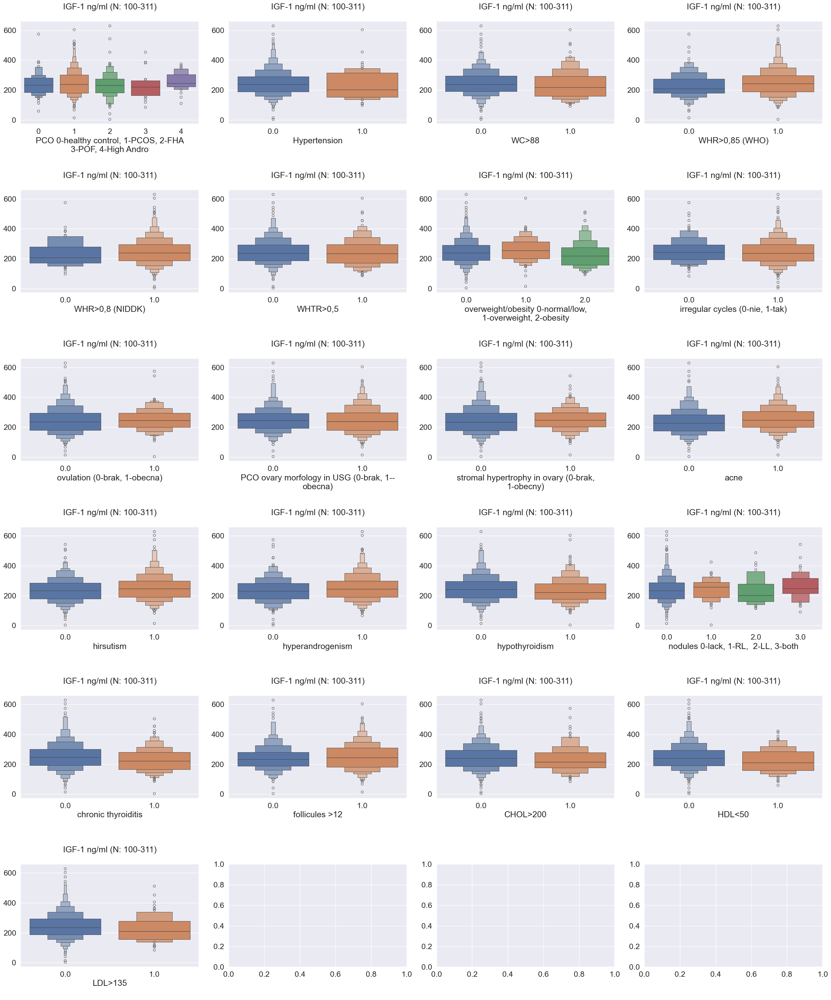

In [49]:
plot_scatterplots_one_to_all_attributes(df, main_attribute=IGF, all_attributes=list(CATEGORICAL_ATTRIBUTES), continuous_data=False, plot_name='IGF-1_vs_categorical_attributes', n_rows=6, n_cols=4, figsize=(25,30))

In [52]:
# plot_scatterplots_one_to_all_attributes(df, main_attribute=VITAMINE_D, all_attributes=list(CATEGORICAL_ATTRIBUTES), continuous_data=False, plot_name='VITAMINE_D_vs_categorical_attributes', n_rows=6, n_cols=4, figsize=(25,60))

In [53]:
# plot diagnosis

from scipy.stats import zscore


def remove_outliers(series, threshold=5):
    # Calculate z-scores for the specific column
    z_scores = np.abs(zscore(series.dropna()))
    print("Z-scores calculated for column:", series.name)

    # Calculate how many entries remain after filtering
    filtered_entries = z_scores < threshold
    print(f"Filtering entries with threshold {threshold}: {filtered_entries.sum()} rows remaining out of {len(series)}. - {filtered_entries.sum()/len(series)*100:.2f}% of the data.")
    
    return series[filtered_entries].index


def plot_one_categorical_to_all_attributes(df, main_attribute, all_attributes, x_label, continuous_data=True, plot_name='plot', n_rows=29, n_cols=5, figsize=(25, 130), should_remove_outliers=False):
    other_attributes = all_attributes
    if main_attribute in other_attributes:
        other_attributes.remove(main_attribute)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    sns.set(font_scale = 1.5)

    for i, other_attribute in enumerate(other_attributes):
        ax = axes[int(i/n_cols)][i%n_cols]

        df_tmp = df.dropna(subset=[main_attribute, other_attribute])
            
        #  TODO: verify if it works correctly
        if should_remove_outliers:
            # Apply outlier removal to the specific column
            indices_to_keep = remove_outliers(df_tmp[other_attribute])
            df_tmp = df_tmp.loc[indices_to_keep]

        if continuous_data:
            sns.boxenplot(data=df_tmp, x=main_attribute, y=other_attribute, hue=main_attribute, legend=False, ax=ax, palette="deep")
        else:
            sns.histplot(data=df_tmp, x=main_attribute, hue=other_attribute, multiple="fill", ax=ax, palette="deep")
            legend = ax.get_legend()
            legend.set_title("\n".join(wrap(other_attribute, 40)))
            legend.set_alpha(0.5)  # Adjust the alpha value (0 to 1) as needed

            sns.move_legend(ax, loc='upper right')

            # counts = df_tmp.groupby([main_attribute, other_attribute]).size().reset_index(name='count')
            # sns.scatterplot(data=counts, x=main_attribute, y=other_attribute, ax=ax, size='count', legend=False, sizes=(100, 1000))
        
        ax.set_title("\n".join(wrap(other_attribute, 40)) + '\n')
        # ax.set_xlabel('0-healthy, 1-PCOS, 2-FHA, 3-POF, 4-High Andro')
        ax.set_xlabel("\n".join(wrap(x_label, 40)))
        ax.set_ylabel('')

    fig.tight_layout()
    plt.savefig(f'../charts/{plot_name}.pdf')
    plt.show()

#### PCOS vs high andro

C:\Users\karin\AppData\Local\Temp\ipykernel_6184\1265282496.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_only_ha_pcos[PCO] = np.where(df_only_ha_pcos[PCO] == 4, 0, df_only_ha_pcos[PCO])


Z-scores calculated for column: IGF-1 ng/ml (N: 100-311)
Filtering entries with threshold 5: 411 rows remaining out of 411. - 100.00% of the data.
Z-scores calculated for column: proBNP
Filtering entries with threshold 5: 341 rows remaining out of 342. - 99.71% of the data.
Z-scores calculated for column: AMH (ng/ml) *7,14=pmol/l
Filtering entries with threshold 5: 299 rows remaining out of 300. - 99.67% of the data.
Z-scores calculated for column: weight
Filtering entries with threshold 5: 585 rows remaining out of 586. - 99.83% of the data.
Z-scores calculated for column: height (cm)
Filtering entries with threshold 5: 585 rows remaining out of 586. - 99.83% of the data.
Z-scores calculated for column: BMI
Filtering entries with threshold 5: 583 rows remaining out of 585. - 99.66% of the data.
Z-scores calculated for column: systolic BP (ciśnienie skurczowe)
Filtering entries with threshold 5: 515 rows remaining out of 515. - 100.00% of the data.
Z-scores calculated for column: diast

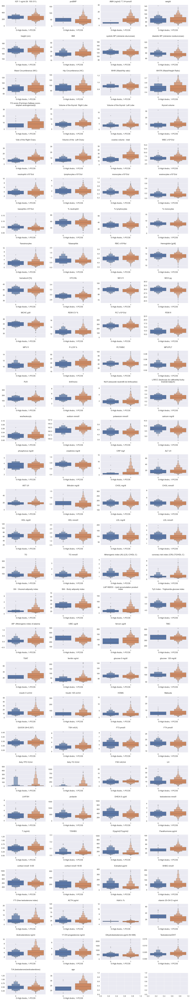

In [58]:
df_only_ha_pcos = df[(df[PCO] == 1) | (df[PCO] == 4)]

#  0 = High Andro, 1 = PCOS
df_only_ha_pcos[PCO] = np.where(df_only_ha_pcos[PCO] == 4, 0, df_only_ha_pcos[PCO])

plot_one_categorical_to_all_attributes(df_only_ha_pcos, main_attribute=PCO, all_attributes=list(CONTINUOUS_ATTRIBUTES), x_label='0-High Andro, 1-PCOS', continuous_data=True, plot_name='PCOS_and_High_Andro_continous_attributes', n_rows=29, n_cols=4, figsize=(25, 130), should_remove_outliers=True)

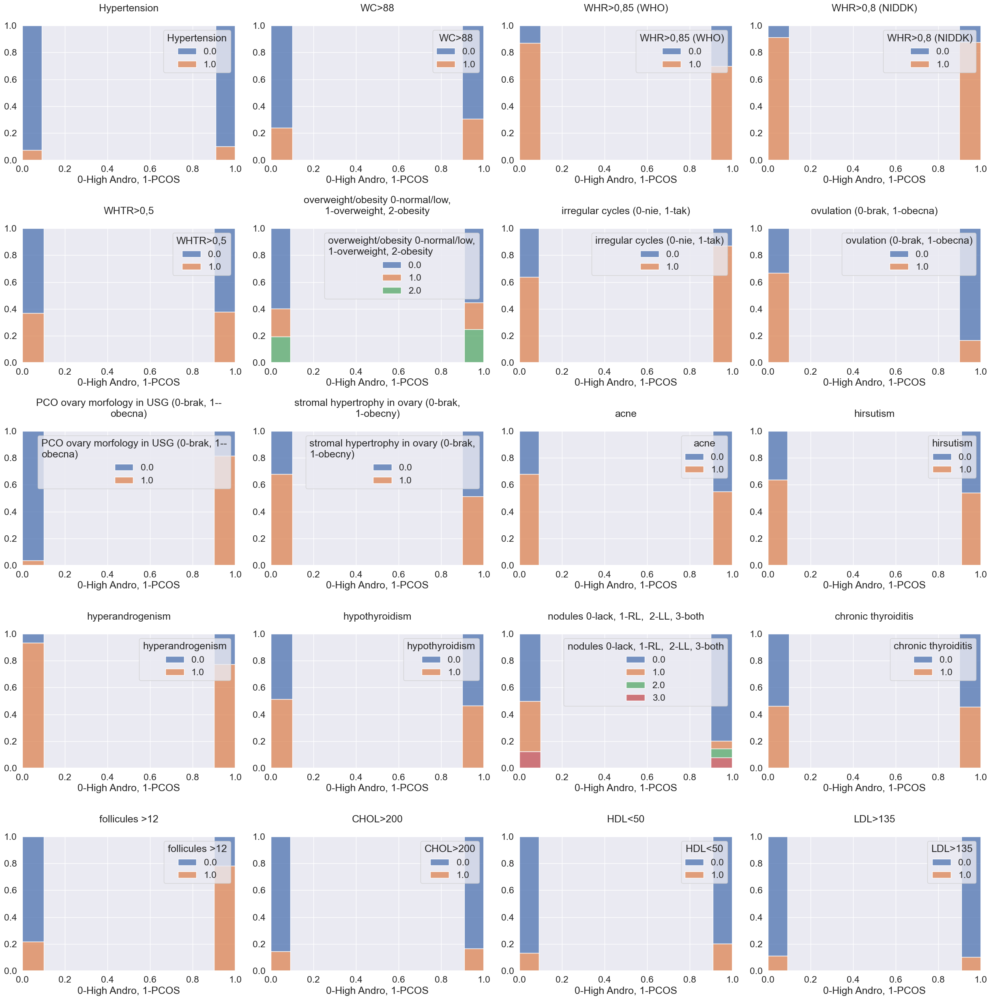

In [62]:
plot_one_categorical_to_all_attributes(df_only_ha_pcos, main_attribute=PCO, all_attributes=list(CATEGORICAL_ATTRIBUTES), x_label='0-High Andro, 1-PCOS', continuous_data=False, plot_name='PCOS_and_High_Andro_categorical_attributes', n_rows=5, n_cols=4, figsize=(25, 25), should_remove_outliers=False)

### healthy, PCOS, High Andro


C:\Users\karin\AppData\Local\Temp\ipykernel_6184\3415389016.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_healthy_pcos_ha[PCO] = np.where(df_healthy_pcos_ha[PCO] == 4, 2, df_healthy_pcos_ha[PCO])


Z-scores calculated for column: IGF-1 ng/ml (N: 100-311)
Filtering entries with threshold 5: 500 rows remaining out of 500. - 100.00% of the data.
Z-scores calculated for column: proBNP
Filtering entries with threshold 5: 476 rows remaining out of 478. - 99.58% of the data.
Z-scores calculated for column: AMH (ng/ml) *7,14=pmol/l
Filtering entries with threshold 5: 359 rows remaining out of 360. - 99.72% of the data.
Z-scores calculated for column: weight
Filtering entries with threshold 5: 792 rows remaining out of 793. - 99.87% of the data.
Z-scores calculated for column: height (cm)
Filtering entries with threshold 5: 792 rows remaining out of 793. - 99.87% of the data.
Z-scores calculated for column: BMI
Filtering entries with threshold 5: 790 rows remaining out of 792. - 99.75% of the data.
Z-scores calculated for column: systolic BP (ciśnienie skurczowe)
Filtering entries with threshold 5: 625 rows remaining out of 625. - 100.00% of the data.
Z-scores calculated for column: diast

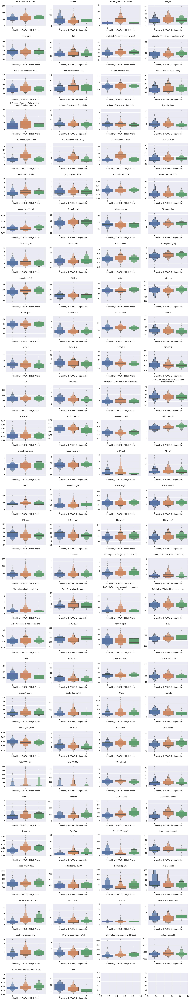

In [70]:
df_healthy_pcos_ha = df[(df[PCO] == 0) | (df[PCO] == 1) | (df[PCO] == 4)]

#  0 = healthy, 1 = PCOS, 2 = High Andro
df_healthy_pcos_ha[PCO] = np.where(df_healthy_pcos_ha[PCO] == 4, 2, df_healthy_pcos_ha[PCO])

plot_one_categorical_to_all_attributes(df_healthy_pcos_ha, main_attribute=PCO, all_attributes=list(CONTINUOUS_ATTRIBUTES), x_label='0-healthy, 1-PCOS, 2-High Andro', continuous_data=True, plot_name='healthy_PCOS_and_High_Andro_continous_attributes', n_rows=29, n_cols=4, figsize=(25, 130), should_remove_outliers=True)

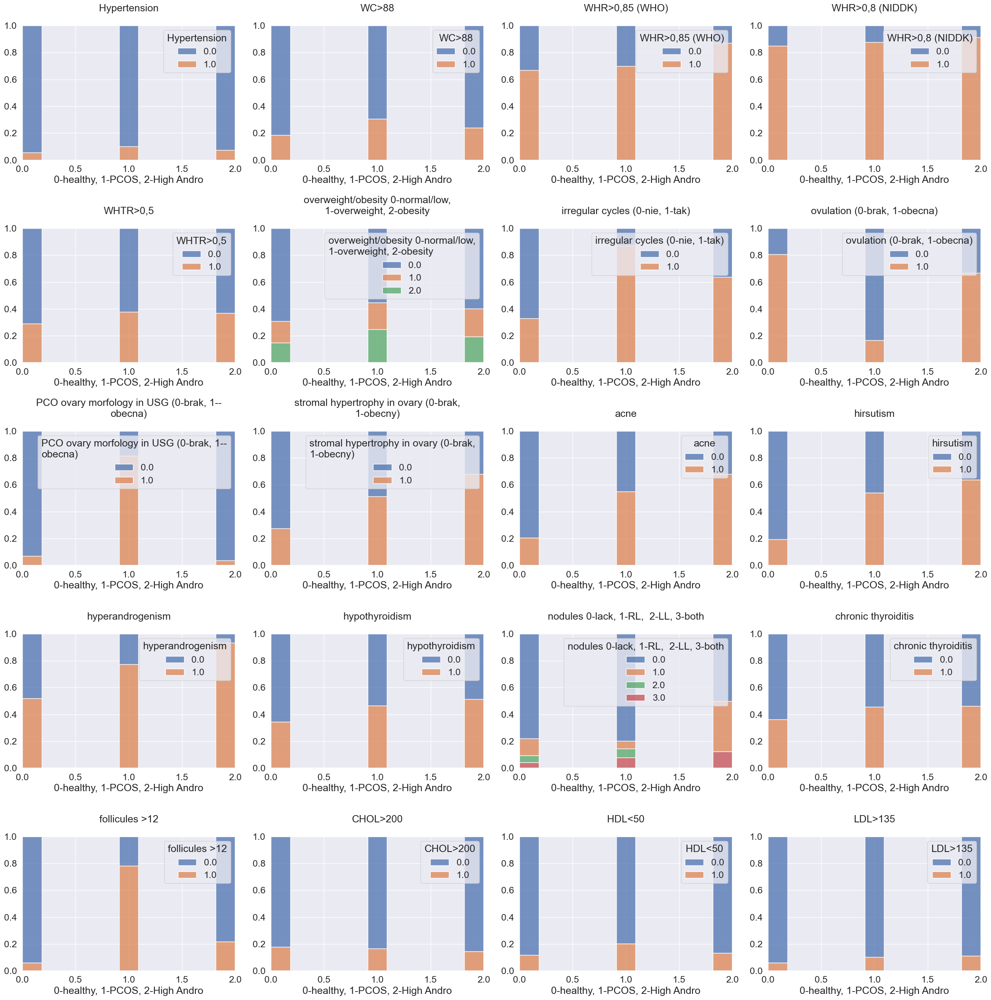

In [65]:
plot_one_categorical_to_all_attributes(df_healthy_pcos_ha, main_attribute=PCO, all_attributes=list(CATEGORICAL_ATTRIBUTES), x_label='0-healthy, 1-PCOS, 2-High Andro', continuous_data=False, plot_name='healthy_PCOS_and_High_Andro_categorical_attributes', n_rows=5, n_cols=4, figsize=(25, 25), should_remove_outliers=False)

### PCOS with BMI < 30

C:\Users\karin\AppData\Local\Temp\ipykernel_6184\3494886094.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pcos_bmi['target'] = np.where((df_pcos_bmi['BMI'] < 30), 0, 1)


Z-scores calculated for column: IGF-1 ng/ml (N: 100-311)
Filtering entries with threshold 5: 379 rows remaining out of 379. - 100.00% of the data.
Z-scores calculated for column: proBNP
Filtering entries with threshold 5: 333 rows remaining out of 334. - 99.70% of the data.
Z-scores calculated for column: AMH (ng/ml) *7,14=pmol/l
Filtering entries with threshold 5: 295 rows remaining out of 296. - 99.66% of the data.
Z-scores calculated for column: weight
Filtering entries with threshold 5: 503 rows remaining out of 504. - 99.80% of the data.
Z-scores calculated for column: height (cm)
Filtering entries with threshold 5: 504 rows remaining out of 504. - 100.00% of the data.
Z-scores calculated for column: BMI
Filtering entries with threshold 5: 502 rows remaining out of 503. - 99.80% of the data.
Z-scores calculated for column: systolic BP (ciśnienie skurczowe)
Filtering entries with threshold 5: 448 rows remaining out of 448. - 100.00% of the data.
Z-scores calculated for column: dias

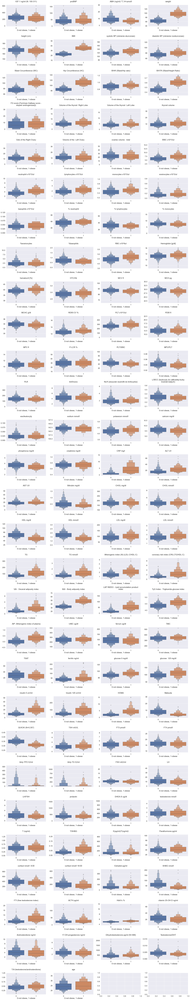

In [73]:
df_pcos_bmi = df[(df[PCO] == 1)]
df_pcos_bmi['target'] = np.where((df_pcos_bmi['BMI'] < 30), 0, 1)

plot_one_categorical_to_all_attributes(df_pcos_bmi, main_attribute='target', all_attributes=list(CONTINUOUS_ATTRIBUTES), x_label='0-not obese, 1-obese', continuous_data=True, plot_name='PCOS_BMI_continous_attributes', n_rows=29, n_cols=4, figsize=(25, 130), should_remove_outliers=True)

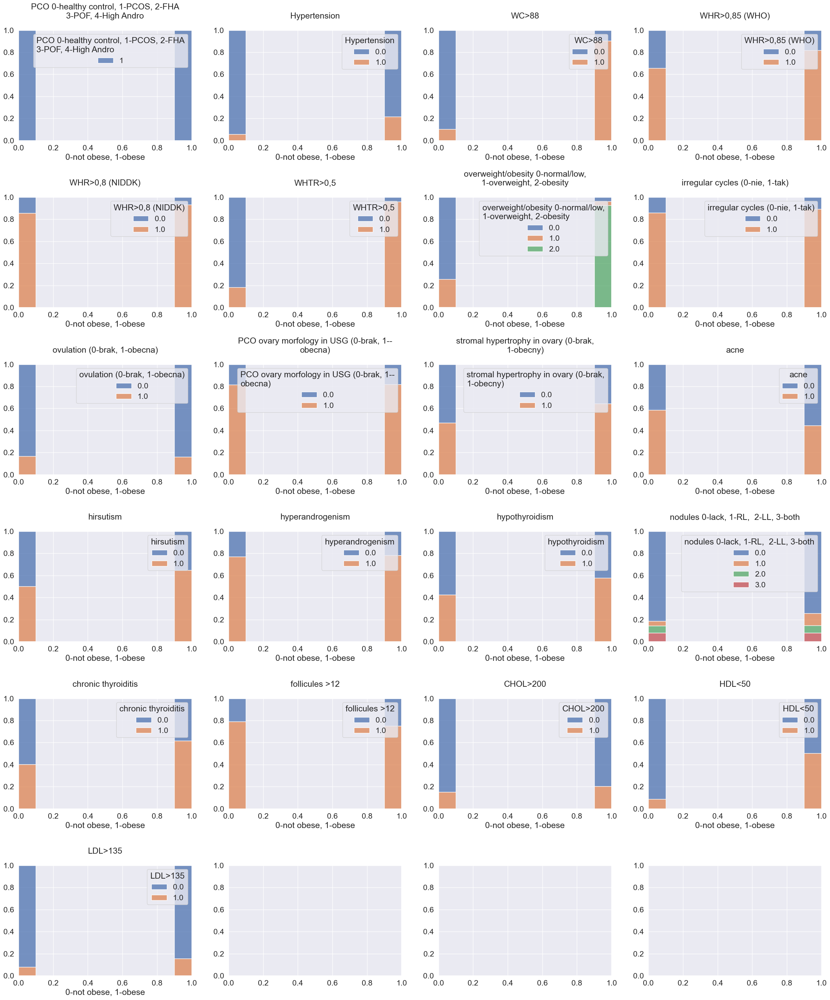

In [76]:
plot_one_categorical_to_all_attributes(df_pcos_bmi, main_attribute='target', all_attributes=list(CATEGORICAL_ATTRIBUTES), x_label='0-not obese, 1-obese', continuous_data=False, plot_name='PCOS_BMI_categorical_attributes', n_rows=6, n_cols=4, figsize=(25, 30), should_remove_outliers=False)

Both healthy and PCOS vs obese

Z-scores calculated for column: IGF-1 ng/ml (N: 100-311)
Filtering entries with threshold 5: 466 rows remaining out of 466. - 100.00% of the data.
Z-scores calculated for column: proBNP
Filtering entries with threshold 5: 445 rows remaining out of 447. - 99.55% of the data.
Z-scores calculated for column: AMH (ng/ml) *7,14=pmol/l
Filtering entries with threshold 5: 341 rows remaining out of 342. - 99.71% of the data.
Z-scores calculated for column: weight
Filtering entries with threshold 5: 709 rows remaining out of 710. - 99.86% of the data.
Z-scores calculated for column: height (cm)
Filtering entries with threshold 5: 710 rows remaining out of 710. - 100.00% of the data.
Z-scores calculated for column: BMI
Filtering entries with threshold 5: 709 rows remaining out of 710. - 99.86% of the data.
Z-scores calculated for column: systolic BP (ciśnienie skurczowe)
Filtering entries with threshold 5: 555 rows remaining out of 555. - 100.00% of the data.
Z-scores calculated for column: dias

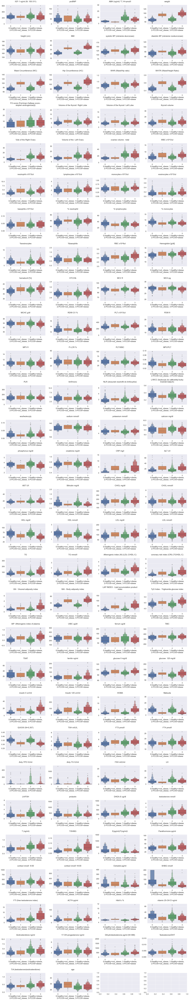

In [81]:
df_bmi = df.copy()
df_bmi['target'] = np.where((df_bmi[PCO] == 0) & (df_bmi['BMI'] < 30), 0,
                        np.where((df_bmi[PCO] == 0) & (df_bmi['BMI'] >= 30), 1,
                                 np.where((df_bmi[PCO] == 1) & (df_bmi['BMI'] < 30), 2, 
                                          np.where((df_bmi[PCO] == 1) & (df_bmi['BMI'] >= 30), 3, None))))

# target: 0 - healthy, not obese, 1 - healthy, obese, 2 - PCOS, not obese, 3 - PCOS, obese
plot_one_categorical_to_all_attributes(df_bmi, main_attribute='target', all_attributes=list(CONTINUOUS_ATTRIBUTES), x_label='0-healthy+not_obese; 1-healthy+obese, 2-PCOS+not_obese, 3-PCOS+obese', continuous_data=True, plot_name='BMI_PCOS+healthy_continous_attributes', n_rows=29, n_cols=4, figsize=(25, 130), should_remove_outliers=True)

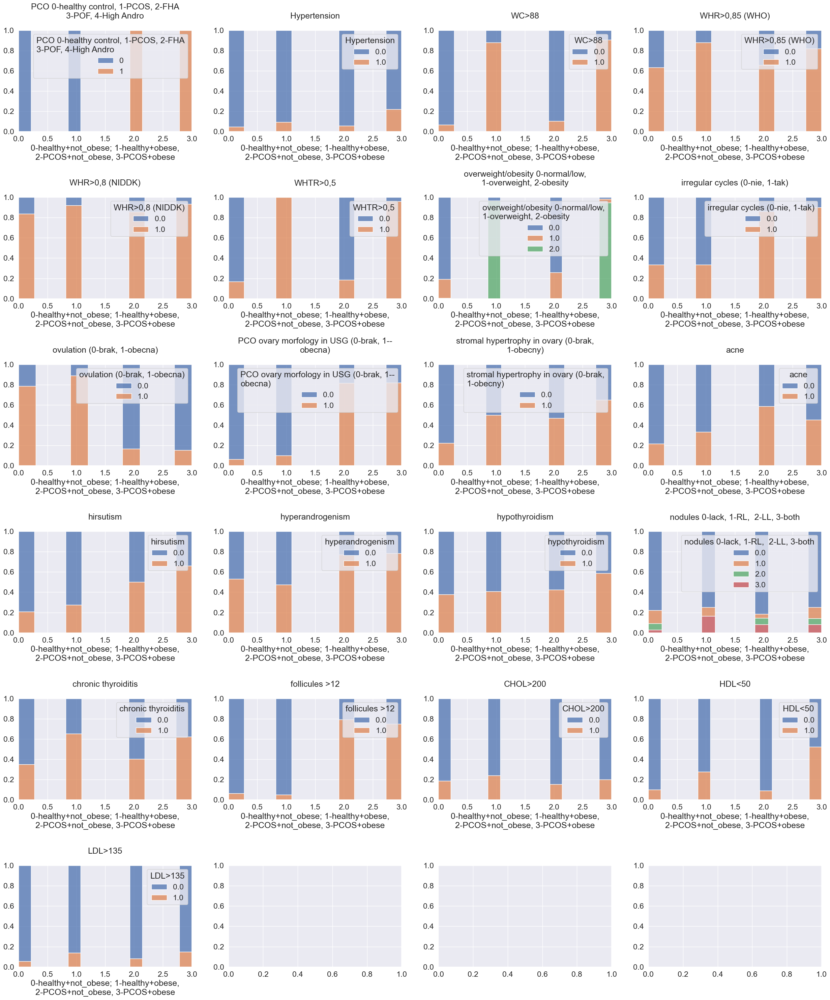

In [82]:
plot_one_categorical_to_all_attributes(df_bmi, main_attribute='target', all_attributes=list(CATEGORICAL_ATTRIBUTES), x_label='0-healthy+not_obese; 1-healthy+obese, 2-PCOS+not_obese, 3-PCOS+obese', continuous_data=False, plot_name='BMI_PCOS+healthy_categorical_attributes', n_rows=6, n_cols=4, figsize=(25, 30), should_remove_outliers=False)

### test combination

In [ ]:
df_new = df.copy()
df_new['target'] = np.where((df_new[PCO] == 0) & (df_new['hyperandrogenism'] == 0), 0,
                        np.where((df_new[PCO] == 0) & (df_new['hyperandrogenism'] == 1), 1,
                                 np.where((df_new[PCO] == 1) & (df_new['hyperandrogenism'] == 0), 2, 
                                          np.where((df_new[PCO] == 1) & (df_new['hyperandrogenism'] == 1), 3, None))))


df_new[['target', PCO, 'hyperandrogenism']].sample(20)

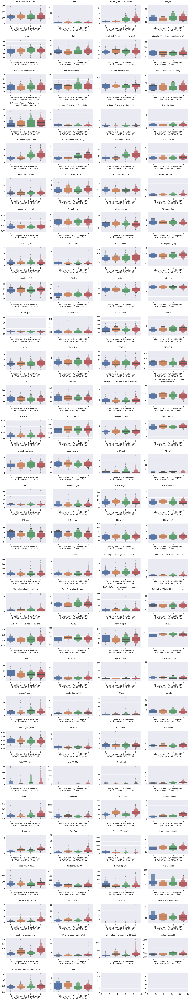

In [62]:
plot_one_categorical_to_all_attributes(df_new, main_attribute='target', all_attributes=list(CONTINUOUS_ATTRIBUTES), x_label='0-healthy+non-HA, 1-healthy+HA, 2-PCOS+non-HA, 3-PCOS+HA', continuous_data=True, plot_name='PCO_vs_continous_attributes', n_rows=29, n_cols=4)

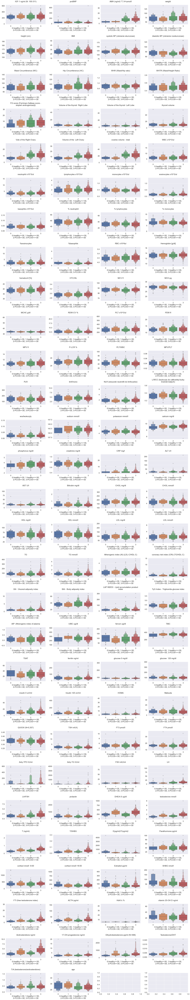

In [63]:
df_age = df.copy()

df_age['target'] = np.where((df_age[PCO] == 0) & (df_age['age'] <  30), 0,
                        np.where((df_age[PCO] == 0) & (df_age['age'] >= 30), 1,
                                 np.where((df_age[PCO] == 1) & (df_age['age'] < 30), 2, 
                                          np.where((df_age[PCO] == 1) & (df_age['age'] >= 30), 3, None))))

plot_one_categorical_to_all_attributes(df_new, main_attribute='target', all_attributes=list(CONTINUOUS_ATTRIBUTES), x_label='0-healthy+<30, 1-healthy+>=30, 2-PCOS+<30, 3-PCOS+>=30', continuous_data=True, plot_name='PCO_vs_continous_attributes', n_rows=29, n_cols=4)

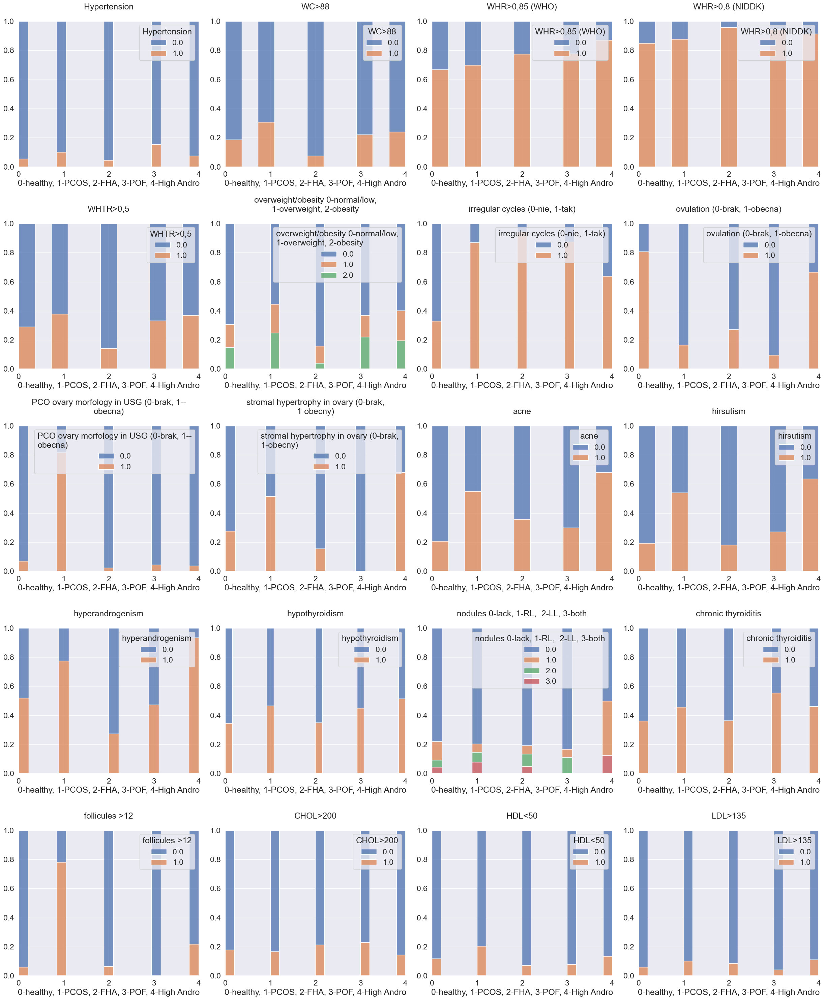

In [20]:
plot_one_categorical_to_all_attributes(df, main_attribute=PCO, all_attributes=list(CATEGORICAL_ATTRIBUTES), x_label='', continuous_data=False, plot_name='PCO_vs_categorical_attributes', n_rows=5, n_cols=4, figsize=(25,30))